# `plot()`: analyze distributions

## Overview

The function `plot()` explores the distributions and statistics of the dataset. It generates a variety of visualizations and statistics which enables the user to achieve a comprehensive understanding of the column distributions and their relationships. The following describes the functionality of `plot()` for a given dataframe `df`.

1. `plot(df)`: plots the distribution of each column and computes dataset statistics
2. `plot(df, col1)`: plots the distribution of column `col1` in various ways, and computes its statistics
3. `plot(df, col1, col2)`: generates plots depicting the relationship between columns `col1` and `col2`

The generated plots are different for numerical, categorical and geography columns. The following table summarizes the output for the different column types.

| `col1` | `col2` | Output |
| --- | --- | --- |
| None | None | dataset statistics, [histogram](https://www.wikiwand.com/en/Histogram) or [bar chart](https://www.wikiwand.com/en/Bar_chart) for each column |
| Numerical | None | column statistics, histogram, [kde plot](https://www.wikiwand.com/en/Kernel_density_estimation), [qq-normal plot](https://www.wikiwand.com/en/Q%E2%80%93Q_plot), [box plot](https://www.wikiwand.com/en/Box_plot) |
| Categorical | None | column statistics, bar chart, [pie chart](https://www.wikiwand.com/en/Pie_chart), [word cloud](https://www.wikiwand.com/en/Tag_cloud), word frequencies |
| Geography | None | column statistics, bar chart, [pie chart](https://www.wikiwand.com/en/Pie_chart), [word cloud](https://www.wikiwand.com/en/Tag_cloud), word frequencies, world map |
| Numerical | Numerical | [scatter plot](https://www.wikiwand.com/en/Scatter_plot), [hexbin plot](https://www.data-to-viz.com/graph/hexbinmap.html), binned box plot|
| Numerical | Categorical | categorical box plot, multi-[line chart](https://www.wikiwand.com/en/Line_chart) |
| Categorical | Numerical | categorical box plot, multi-line chart
| Categorical | Categorical | [nested bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [stacked bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [heat map](https://www.wikiwand.com/en/Heat_map) |
| Categorical | Geography | [nested bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [stacked bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [heat map](https://www.wikiwand.com/en/Heat_map) |
| Geography | Categorical | [nested bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [stacked bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [heat map](https://www.wikiwand.com/en/Heat_map) |
| Geopoint | Categorical | [nested bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [stacked bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [heat map](https://www.wikiwand.com/en/Heat_map) |
| Categorical | Geopoint | [nested bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [stacked bar chart](https://www.wikiwand.com/en/Bar_chart#/Grouped_and_stacked), [heat map](https://www.wikiwand.com/en/Heat_map) |
| Numerical | Geography | categorical box plot, multi-[line chart](https://www.wikiwand.com/en/Line_chart), world map |
| Geography | Numerical | categorical box plot, multi-[line chart](https://www.wikiwand.com/en/Line_chart), world map |
| Numerical | Geopoint | geo map|
| Geopoint | Numerical | geo map|

Next, we demonstrate the functionality of `plot()`. 

## Load the dataset
`dataprep.eda` supports **Pandas** and **Dask** dataframes. Here, we will load the well-known [adult dataset](http://archive.ics.uci.edu/ml/datasets/Adult) into a Pandas dataframe using the load_dataset function.

In [1]:
from dataprep.datasets import load_dataset
import numpy as np
df = load_dataset('adult')
df = df.replace(" ?", np.NaN)

## Get an overview of the dataset with `plot(df)`

We start by calling `plot(df)` which computes dataset-level statistics, a histogram for each numerical column, and a bar chart for each categorical column. The number of bins in the histogram can be specified with the parameter `bins`, and the number of categories in the bar chart can be specified with the parameter `ngroups`. If a column contains missing values, the percent of missing values is shown in the title and ignored when generating the plots.

  0%|          | 0/612 [00:00<?, ?it/s]


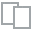
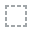
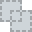
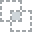
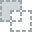
...
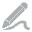
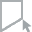
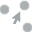
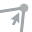
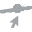

In [2]:
from dataprep.eda import plot
plot(df)

## Understand a column with `plot(df, col1)`

After getting an overview of the dataset, we can thoroughly investigate a column of interest `col1` using `plot(df, col1)`. The output is of `plot(df, col1)` is different for numerical and categorical columns.

When `col1` is a numerical column, it  computes column statistics, and generates a histogram, kde plot, box plot and qq-normal plot:

  0%|          | 0/110 [00:00<?, ?it/s]


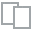
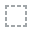
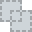
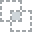
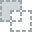
...
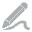
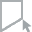
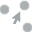
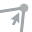
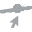

In [3]:
plot(df, "age")

When `x` is a categorical column, it computes column statistics, and plots a bar chart, pie chart, word cloud, word frequency and word length:

  0%|          | 0/72 [00:00<?, ?it/s]


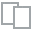
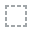
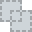
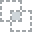
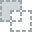
...
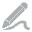
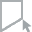
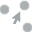
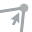
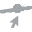

In [4]:
plot(df, "education")

When `x` is a Geography column, it computes column statistics, and plots a bar chart, pie chart, word cloud, word frequency, word length and world map:

  0%|          | 0/72 [00:00<?, ?it/s]


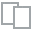
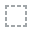
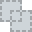
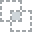
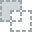
...
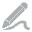
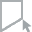
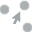
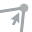
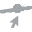

In [5]:
df_geo = load_dataset('countries')
plot(df_geo, "Country")

## Understand the relationship between two columns with `plot(df, col1, col2)`

Next, we can explore the relationship between columns `col1` and `col2` using `plot(df, col1, col2)`. The output depends on the types of the columns. 

When `col1` and `col2` are both numerical columns, it generates a scatter plot, hexbin plot and box plot:

  0%|          | 0/10 [00:00<?, ?it/s]


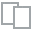
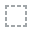
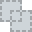
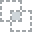
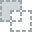
...
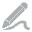
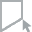
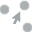
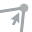
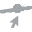

In [6]:
plot(df, "age", "hours-per-week")

When `col1` and `col2` are both categorical columns, it plots a nested bar chart, stacked bar chart and heat map:


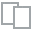
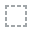
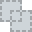
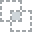
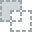
...
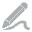
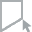
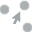
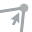
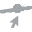

In [7]:
plot(df, "education", "marital-status")

When `col1` and `col2` are one each of type numerical and categorical, it generates a box plot per category and a multi-line chart:

  0%|          | 0/38 [00:00<?, ?it/s]


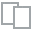
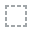
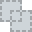
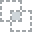
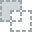
...
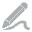
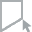
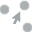
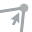
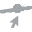

In [8]:
plot(df, "age", "education")
# or plot(df, "education", "age")

When `col1` and `col2` are one each of type geopoint and categorical, or, geography and categorical, it generates a box plot per category and a multi-line chart:


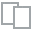
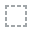
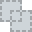
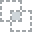
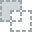
...
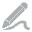
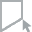
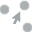
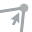
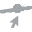

In [9]:
from dataprep.eda.dtypes_v2 import LatLong
covid = load_dataset('covid19')
latlong = LatLong("Lat", "Long") # create geopoint type using "LatLong" function by inputing two columns names
plot(covid, latlong, "Country/Region")
# or plot(covid, "Country/Region", latlong)

plot(df_geo,"Country", "Region")
# or plot(df_geo, "Region", "Country")

When `col1` and `col2` are one each of type geography and numerical, it generates a box plot per category, a multi-line chart and a world map:

  0%|          | 0/43 [00:00<?, ?it/s]


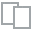
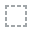
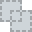
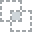
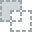
...
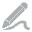
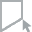
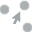
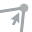
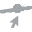

In [10]:
plot(df_geo,"Country", "Population")
# or plot(df_geo, "Population", "Country")

When `col1` and `col2` are one each of type geopoint and numerical, it generates a geo map:

  0%|          | 0/6 [00:00<?, ?it/s]


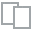
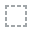
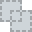
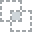
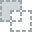
...
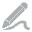
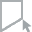
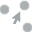
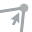
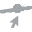

In [11]:
plot(covid, latlong, "2/16/2020")
# or plot(covid, "2/16/2020", latlong)